In [1]:
import numpy as np
import pandas as pd
import requests
import subprocess
import warnings
warnings.filterwarnings("ignore")

import tensorflow as tf
from tensorflow.keras import Sequential
from tensorflow.keras.layers import Dense
from tensorflow.keras import layers

import keras


from sklearn.preprocessing import PowerTransformer, StandardScaler, MinMaxScaler, OneHotEncoder
from sklearn.model_selection import train_test_split, KFold
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

def metrics_evals(y_true,y_pred, X_test):
    mse = mean_squared_error(y_true, y_pred)
    rmse = mean_squared_error(y_true, y_pred, squared=False)
    mae = mean_absolute_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    adj_r2 = 1 - (1-r2)*(len(y_true)-1)/(len(y_true)-X_test.shape[1]-1)

    return {"MSE":mse,
            "RMSE":rmse,
            "MAE":mae,
            "R2":r2,
            "ADJ_R2": adj_r2}

import scipy.stats as stats
import matplotlib.pyplot as plt
import seaborn as sns

# For Reproducibility
np.random.seed(42)
tf.random.set_seed(42)



data_link = "https://drive.google.com/file/d/1clZX-lV_MLxKHSyeyTheX5OCQtNCUcqT/view?usp=sharing"

!gdown 1clZX-lV_MLxKHSyeyTheX5OCQtNCUcqT

# def download_url(url, save_path, chunk_size=128):
#     r = requests.get(url, stream=True)
#     with open(save_path, 'wb') as fd:
#         for chunk in r.iter_content(chunk_size=chunk_size):
#             fd.write(chunk)

# download_url(url=data_link, save_path='data/dataset.zip')

# importing required modules
from zipfile import ZipFile

# specifying the zip file name
file_name = "ninjacart_data.zip"

# opening the zip file in READ mode
with ZipFile(file_name, 'r') as zip:
	# printing all the contents of the zip file
	zip.printdir()

	# extracting all the files
	print('Extracting all the files now...')
	zip.extractall()
	print('Done!')

ModuleNotFoundError: No module named 'numpy'

In [ ]:
#tf.distribute.Strategy is a TensorFlow API to distribute training across multiple GPUs,
#multiple machines, or TPUs. Using this API, you can distribute your existing models and
#training code with minimal code changes.


try:
    tpu = tf.distribute.cluster_resolver.TPUClusterResolver.connect()
    print("Device:", tpu.master())
    strategy = tf.distribute.TPUStrategy(tpu)
except:
    strategy = tf.distribute.get_strategy()
print("Number of replicas:", strategy.num_replicas_in_sync)

Number of replicas: 1


In [ ]:
AUTOTUNE = tf.data.AUTOTUNE

# Specifying our training batch size
BATCH_SIZE = 32 * strategy.num_replicas_in_sync

# Specifying the image size
IMAGE_SIZE = [224, 224]

# List containing class names, which will be used to index on our model output
# 0 = NORMAL, 1 = PNEUMONIA
CLASS_NAMES = ["tomato", "potato", "onion", "indian market"]



### Visualizing across classes

In [ ]:
import random
import os
import glob

class_dirs = os.listdir("ninjacart_data/train/") # list all directories inside "train" folder
image_dict = {} # dict to store image array(key) for every class(value)
count_dict = {} # dict to store count of files(key) for every class(value)
# iterate over all class_dirs
for cls in class_dirs:
    # get list of all paths inside the subdirectory
    file_paths = glob.glob(f'ninjacart_data/train/{cls}/*')
    # count number of files in each class and add it to count_dict
    count_dict[cls] = len(file_paths)
    # select random item from list of image paths
    image_path = random.choice(file_paths)
    # load image using keras utility function and save it in image_dict
    image_dict[cls] = tf.keras.utils.load_img(image_path)

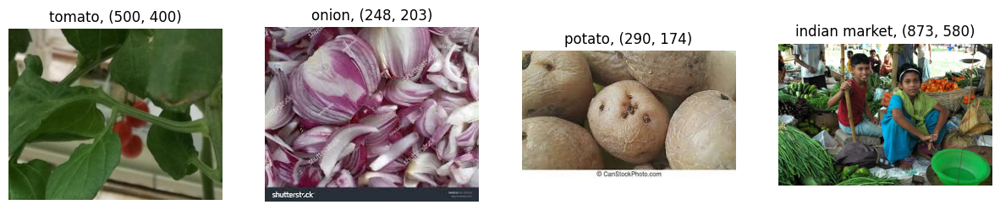

In [ ]:
## Viz Random Sample from each class

plt.figure(figsize=(15, 12))
# iterate over dictionary items (class label, image array)
for i, (cls,img) in enumerate(image_dict.items()):
    # create a subplot axis
    ax = plt.subplot(3, 4, i + 1)
    # plot each image
    plt.imshow(img)
    # set "class name" along with "image size" as title
    plt.title(f'{cls}, {img.size}')
    plt.axis("off")

Count of training samples per class:
            class  count
0         tomato    789
1          onion    849
2         potato    898
3  indian market    599


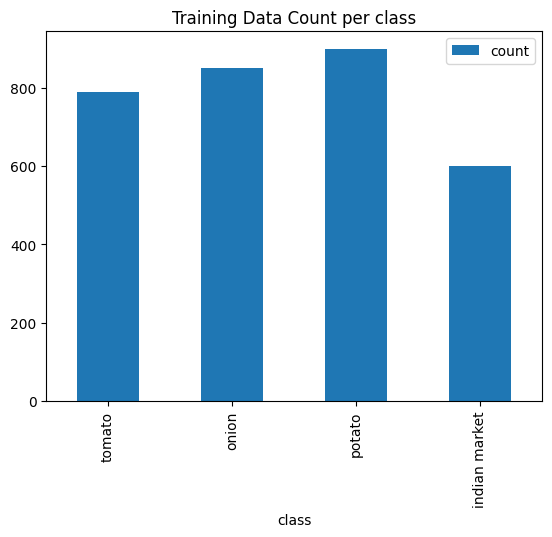

In [ ]:
## Let's now Plot the Data Distribution of Training Data across Classes
df_count_train = pd.DataFrame({
    "class": count_dict.keys(),     # keys of count_dict are class labels
    "count": count_dict.values(),   # value of count_dict contain counts of each class
})
print("Count of training samples per class:\n", df_count_train)

# draw a bar plot using pandas in-built plotting function
df_count_train.plot.bar(x='class', y='count', title="Training Data Count per class")
plt.show()

In [ ]:
class_dirs = os.listdir("ninjacart_data/test/") # list all directories inside "train" folder
image_dict = {} # dict to store image array(key) for every class(value)
count_dict = {} # dict to store count of files(key) for every class(value)
# iterate over all class_dirs
for cls in class_dirs:
    # get list of all paths inside the subdirectory
    file_paths = glob.glob(f'ninjacart_data/test/{cls}/*')
    # count number of files in each class and add it to count_dict
    count_dict[cls] = len(file_paths)
    # select random item from list of image paths
    image_path = random.choice(file_paths)
    # load image using keras utility function and save it in image_dict
    image_dict[cls] = tf.keras.utils.load_img(image_path)

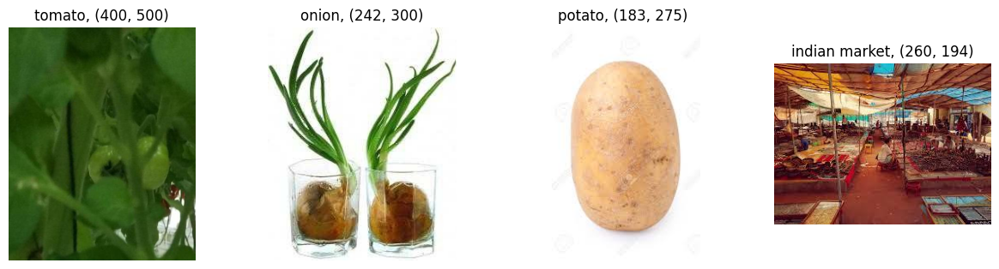

In [ ]:
## Viz Random Sample from each class

plt.figure(figsize=(15, 12))
# iterate over dictionary items (class label, image array)
for i, (cls,img) in enumerate(image_dict.items()):
    # create a subplot axis
    ax = plt.subplot(3, 4, i + 1)
    # plot each image
    plt.imshow(img)
    # set "class name" along with "image size" as title
    plt.title(f'{cls}, {img.size}')
    plt.axis("off")

Count of training samples per class:
            class  count
0         tomato    106
1          onion     83
2         potato     81
3  indian market     81


<Axes: title={'center': 'Testing Data Count per class'}, xlabel='class'>

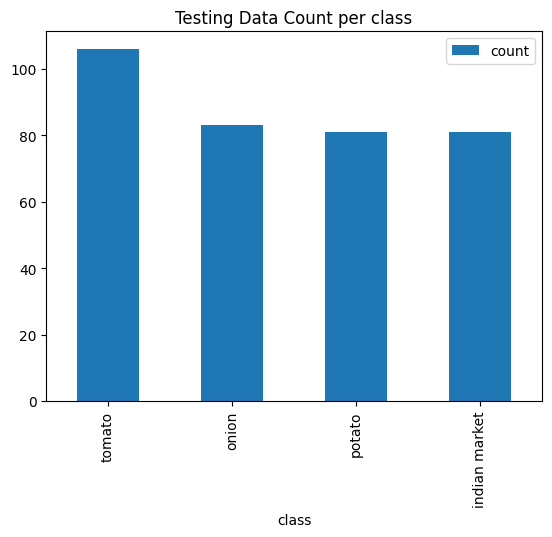

In [ ]:
## Let's now Plot the Data Distribution of Testing Data across Classes
df_count_test = pd.DataFrame({
    "class": count_dict.keys(),     # keys of count_dict are class labels
    "count": count_dict.values(),   # value of count_dict contain counts of each class
})
print("Count of training samples per class:\n", df_count_test)

# draw a bar plot using pandas in-built plotting function
df_count_test.plot.bar(x='class', y='count', title="Testing Data Count per class")

### Preprocessing data

In [ ]:
def preprocess(train_data, val_data, test_data, target_height=227, target_width=227):

    # Data Processing Stage with resizing and rescaling operations
    data_preprocess = tf.keras.Sequential(
        name="data_preprocess",
        layers=[
            tf.keras.layers.Resizing(target_height, target_width),
            tf.keras.layers.Rescaling(1.0/255),
        ]
    )

    # Perform Data Processing on the train, test dataset
    train_ds = train_data.map(lambda x, y: (data_preprocess(x), y), num_parallel_calls=tf.data.AUTOTUNE)
    val_ds = val_data.map(lambda x, y: (data_preprocess(x), y), num_parallel_calls=tf.data.AUTOTUNE)
    test_ds = test_data.map(lambda x, y: (data_preprocess(x), y), num_parallel_calls=tf.data.AUTOTUNE)

    return train_ds, val_ds, test_ds

In [ ]:
!pip install split-folders

In [ ]:
import splitfolders

In [ ]:
input_folder = "ninjacart_data/train/"
splitfolders.ratio(input_folder, output="output", seed=1337, ratio=(.8, .2), group_prefix=None, move=False)

Copying files: 3135 files [00:02, 1466.04 files/s]


In [ ]:
train_data = tf.keras.utils.image_dataset_from_directory("output/train/",shuffle=True, seed=123,image_size=(227, 227),batch_size=32)
val_data = tf.keras.utils.image_dataset_from_directory("output/val/",shuffle=False, seed=123,image_size=(227, 227),batch_size=32)
test_data = tf.keras.utils.image_dataset_from_directory("ninjacart_data/test/",shuffle=False, seed=123,image_size=(227, 227),batch_size=32)

train_ds, val_ds, test_ds = preprocess(train_data, val_data, test_data)

categories = train_data.class_names

cats = ", ".join(categories)
print(f"\nThe classes are available: {cats}")

Found 2507 files belonging to 4 classes.
Found 628 files belonging to 4 classes.
Found 351 files belonging to 4 classes.

The classes are available: indian market, onion, potato, tomato


#### Treating Class Imbalance

In [ ]:
DIR = 'output/train/indian market/'
COUNT_INDIAN_MARKET = len([name for name in os.listdir(DIR) if os.path.isfile(os.path.join(DIR, name))])
print(f'Indian Market images count in training set: {COUNT_INDIAN_MARKET}')

DIR = 'output/train/onion/'
COUNT_ONION = len([name for name in os.listdir(DIR) if os.path.isfile(os.path.join(DIR, name))])
print(f'Onion images count in training set: {COUNT_ONION}')

DIR = 'output/train/potato/'
COUNT_POTATO = len([name for name in os.listdir(DIR) if os.path.isfile(os.path.join(DIR, name))])
print(f'Potato images count in training set: {COUNT_POTATO}')

DIR = 'output/train/tomato/'
COUNT_TOMATO = len([name for name in os.listdir(DIR) if os.path.isfile(os.path.join(DIR, name))])
print(f'Tomato images count in training set: {COUNT_TOMATO}')

TOTAL_COUNT = COUNT_INDIAN_MARKET+COUNT_ONION+COUNT_POTATO+COUNT_TOMATO
print('Total Count of images:', TOTAL_COUNT)

Indian Market images count in training set: 479
Onion images count in training set: 679
Potato images count in training set: 718
Tomato images count in training set: 631
Total Count of images: 2507


In [ ]:
# Scaling by total/2 helps keep the loss to a similar magnitude.
# The sum of the weights of all examples stays the same.

weight_for_0 = (1 / COUNT_INDIAN_MARKET) * (TOTAL_COUNT)  / 2.0
weight_for_1 = (1 / COUNT_ONION) * (TOTAL_COUNT) / 2.0
weight_for_2 = (1 / COUNT_POTATO) * (TOTAL_COUNT) / 2.0
weight_for_3 = (1 / COUNT_TOMATO) * (TOTAL_COUNT) / 2.0

class_weight = {0: weight_for_0, 1: weight_for_1, 2: weight_for_2, 3: weight_for_3}

print("Weight for class 0: {:.2f}".format(weight_for_0))
print("Weight for class 1: {:.2f}".format(weight_for_1))
print("Weight for class 2: {:.2f}".format(weight_for_2))
print("Weight for class 3: {:.2f}".format(weight_for_3))

Weight for class 0: 2.62
Weight for class 1: 1.85
Weight for class 2: 1.75
Weight for class 3: 1.99


### Modelling

#### Baseline Model

In [ ]:
def baseline(height=227, width=227):
    num_classes = 4
    hidden_size = 256

    model = tf.keras.Sequential(
        name="baseline_cnn_model",
        layers=[
            tf.keras.layers.Conv2D(filters=16, kernel_size=3, padding="same", activation='relu', input_shape=(height, width, 3)),
            tf.keras.layers.MaxPooling2D(),
            tf.keras.layers.Flatten(),
            tf.keras.layers.Dense(units=hidden_size, activation='relu'),
            tf.keras.layers.Dense(units=num_classes, activation='softmax')
        ]
    )
    return model

In [ ]:
model = baseline()
model.summary()

Model: "baseline_cnn_model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 227, 227, 16)      448       
                                                                 
 max_pooling2d (MaxPooling2  (None, 113, 113, 16)      0         
 D)                                                              
                                                                 
 flatten (Flatten)           (None, 204304)            0         
                                                                 
 dense (Dense)               (None, 256)               52302080  
                                                                 
 dense_1 (Dense)             (None, 4)                 1028      
                                                                 
Total params: 52303556 (199.52 MB)
Trainable params: 52303556 (199.52 MB)
Non-trainable params: 0 (0.00 Byte)
____

In [ ]:
# !pip install tensorboard

In [ ]:
# tensorboard setup for visualization
log_dir = "pistol_Log"
!rm -rf log_dir

In [ ]:
def compile_train_v1(model, train_ds, val_ds, epochs=10, ckpt_path="/tmp/checkpoint"):
    # tf.compat.v1.disable_eager_execution()
    model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=["accuracy"])

    tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir)
    checkpoint_cb = tf.keras.callbacks.ModelCheckpoint(ckpt_path, save_weights_only=True, monitor='val_loss', mode='min', save_best_only=True)
    early_stopping_cb = tf.keras.callbacks.EarlyStopping(patience=10, restore_best_weights=True)

    model_fit = model.fit(train_ds, validation_data=val_ds,
                          epochs=epochs,
                          class_weight = class_weight,
                          callbacks=[checkpoint_cb, early_stopping_cb, tensorboard_callback])

    return model_fit

In [ ]:
model_fit = compile_train_v1(model, train_ds, val_ds, epochs=15)

Epoch 1/15
79/79 [==============================] - 24s 178ms/step - loss: 14.6464 - accuracy: 0.5505 - val_loss: 0.6484 - val_accuracy: 0.7882
Epoch 2/15
79/79 [==============================] - 23s 278ms/step - loss: 0.8788 - accuracy: 0.8400 - val_loss: 0.5487 - val_accuracy: 0.7834
Epoch 3/15
79/79 [==============================] - 18s 195ms/step - loss: 0.4522 - accuracy: 0.9202 - val_loss: 0.5329 - val_accuracy: 0.8089
Epoch 4/15
79/79 [==============================] - 10s 119ms/step - loss: 0.2659 - accuracy: 0.9617 - val_loss: 0.6422 - val_accuracy: 0.7643
Epoch 5/15
79/79 [==============================] - 11s 137ms/step - loss: 0.1648 - accuracy: 0.9757 - val_loss: 0.5655 - val_accuracy: 0.8073
Epoch 6/15
79/79 [==============================] - 11s 129ms/step - loss: 0.1226 - accuracy: 0.9797 - val_loss: 0.5910 - val_accuracy: 0.8137
Epoch 7/15
79/79 [==============================] - 10s 119ms/step - loss: 0.0880 - accuracy: 0.9872 - val_loss: 0.6056 - val_accuracy: 0.823

In [ ]:
# Implement a TensorBoard callback to log each of our model metrics for each model during the training process.
%load_ext tensorboard
%tensorboard --logdir={log_dir}

<IPython.core.display.Javascript object>

11/11 [==============================] - 1s 105ms/step
              precision    recall  f1-score   support

           0       0.90      0.65      0.76        81
           1       0.66      0.54      0.60        83
           2       0.60      0.88      0.71        81
           3       1.00      0.99      1.00       106

    accuracy                           0.78       351
   macro avg       0.79      0.77      0.76       351
weighted avg       0.80      0.78      0.78       351



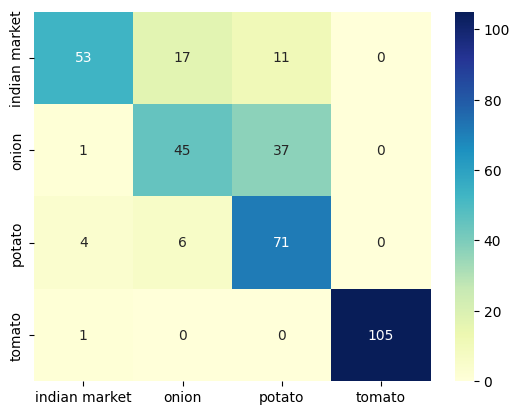

In [ ]:
from sklearn.metrics import classification_report, confusion_matrix

def ConfusionMatrix(model, ds, label_list):
# Note: This logic doesn't work with shuffled datasets
    # run model prediction and obtain probabilities
    y_pred = model.predict(ds)
    # get list of predicted classes by taking argmax of the probabilities(y_pred)
    predicted_categories = tf.argmax(y_pred, axis=1)
    # create list of all "y"s labels, by iterating over test dataset
    true_categories = tf.concat([y for x, y in ds], axis=0)

    print(classification_report(true_categories, predicted_categories))

    # generate confusion matrix and plot it
    cm = confusion_matrix(true_categories,predicted_categories) # last batch
    sns.heatmap(cm, annot=True, xticklabels=label_list, yticklabels=label_list, cmap="YlGnBu", fmt='g')
    plt.show()

ConfusionMatrix(model, test_ds, test_data.class_names)

In [ ]:
fig, ax = plt.subplots(1, 2, figsize=(20, 6))
ax = ax.ravel()

for i, met in enumerate(["accuracy", "loss"]):
    ax[i].plot(model_fit.history[met])
    ax[i].plot(model_fit.history["val_" + met])
    ax[i].set_title("Model {}".format(met))
    ax[i].set_xlabel("epochs")
    ax[i].set_ylabel(met)
    ax[i].legend(["train", "val"])

In [ ]:
# Evaluate the model
loss, acc = model.evaluate(test_ds, verbose=2)
print("Accuracy of the Model with Test Data: {:5.2f}%".format(100 * acc))
print("Loss of the Model with Test Data: {:5.4f}".format(loss))


In [ ]:
def plot_image(pred_array, true_label, img):
  plt.grid(False)
  plt.xticks([])
  plt.yticks([])

  plt.imshow(img, cmap=plt.cm.binary)

  predicted_label = np.argmax(pred_array)
  if predicted_label == true_label:
    color = 'blue'
  else:
    color = 'red'

  plt.xlabel("{} {:2.0f}% ".format(class_names[predicted_label].capitalize(),
                                100*np.max(pred_array),
                                ),
                                color=color)

In [ ]:
true_categories = tf.concat([y for x, y in test_ds], axis=0)
images = tf.concat([x for x, y in test_ds], axis=0)
y_pred = model.predict(test_ds)
class_names = test_data.class_names

# Randomly sample 15 test images and plot it with their predicted labels, and the true labels.
indices = random.sample(range(len(images)), 15)
# Color correct predictions in blue and incorrect predictions in red.
num_rows = 5
num_cols = 3
num_images = num_rows*num_cols
plt.figure(figsize=(4*num_cols, 2*num_rows))
for i,index in enumerate(indices):
  plt.subplot(num_rows, num_cols, i+1)
  plot_image(y_pred[index], true_categories[index], images[index])

plt.tight_layout()
plt.show()

#### Modification 1 with Baseline

In [ ]:
def mod1_cnn_model(height=128, width=128):
    num_classes = 4
    hidden_size = 256

    model = tf.keras.Sequential(
        name="mod1_cnn_model",
        layers=[
            # tf.keras.layers.Dropout(0.5),
            tf.keras.layers.Conv2D(filters=16, kernel_size=3, padding="same", input_shape=(height, width, 3)),
            tf.keras.layers.Activation("relu"),
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.MaxPooling2D(),
            tf.keras.layers.Conv2D(filters=32, kernel_size=3, padding="same"),
            tf.keras.layers.Activation("relu"),
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.MaxPooling2D(),
            tf.keras.layers.Conv2D(filters=64, kernel_size=3, padding="same"),
            tf.keras.layers.Activation("relu"),
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.MaxPooling2D(),
            tf.keras.layers.Conv2D(filters=128, kernel_size=3, padding="same"),
            tf.keras.layers.Activation("relu"),
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.MaxPooling2D(),
            tf.keras.layers.Conv2D(filters=256, kernel_size=3, padding="same"),
            tf.keras.layers.Activation("relu"),
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.GlobalAveragePooling2D(),
            tf.keras.layers.Dense(units=hidden_size),
            tf.keras.layers.Activation("relu"),
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.Dropout(0.5),
            tf.keras.layers.Dense(units=num_classes, activation='softmax')
        ]
    )

    model.build(input_shape = (None, height, width, 3))

    return model

In [ ]:
model = mod1_cnn_model(height=227, width=227)
model.summary()

Model: "mod1_cnn_model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_1 (Conv2D)           (None, 227, 227, 16)      448       
                                                                 
 activation (Activation)     (None, 227, 227, 16)      0         
                                                                 
 batch_normalization (Batch  (None, 227, 227, 16)      64        
 Normalization)                                                  
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 113, 113, 16)      0         
 g2D)                                                            
                                                                 
 conv2d_2 (Conv2D)           (None, 113, 113, 32)      4640      
                                                                 
 activation_1 (Activation)   (None, 113, 113, 32)   

In [ ]:
# tensorboard setup for visualization
log_dir = "pistol_Log"
!rm -rf log_dir

In [ ]:
model_fit = compile_train_v1(model, train_ds, val_ds, epochs=30)

In [ ]:
# Implement a TensorBoard callback to log each of our model metrics for each model during the training process.
%load_ext tensorboard
%tensorboard --logdir={log_dir}

In [ ]:
fig, ax = plt.subplots(1, 2, figsize=(20, 7))
ax = ax.ravel()

for i, met in enumerate(["accuracy", "loss"]):
    ax[i].plot(model_fit.history[met])
    ax[i].plot(model_fit.history["val_" + met])
    ax[i].set_title("Model {}".format(met))
    ax[i].set_xlabel("epochs")
    ax[i].set_ylabel(met)
    ax[i].legend(["train", "val"])

In [ ]:
ConfusionMatrix(model, test_ds, test_data.class_names)

In [ ]:
# Evaluate the model
loss, acc = model.evaluate(test_ds, verbose=2)
print("Accuracy of the Model with Test Data: {:5.2f}%".format(100 * acc))
print("Loss of the Model with Test Data: {:5.4f}".format(loss))

In [ ]:
true_categories = tf.concat([y for x, y in test_ds], axis=0)
images = tf.concat([x for x, y in test_ds], axis=0)
y_pred = model.predict(test_ds)
class_names = test_data.class_names

# Randomly sample 15 test images and plot it with their predicted labels, and the true labels.
indices = random.sample(range(len(images)), 15)
# Color correct predictions in blue and incorrect predictions in red.
num_rows = 5
num_cols = 3
num_images = num_rows*num_cols
plt.figure(figsize=(4*num_cols, 2*num_rows))
for i,index in enumerate(indices):
  plt.subplot(num_rows, num_cols, i+1)
  plot_image(y_pred[index], true_categories[index], images[index])

plt.tight_layout()
plt.show()

### Modification 2 with Baseline

In [ ]:
def mod2_cnn_model(height=128, width=128):
    num_classes = 4
    hidden_size = 256

    model = keras.Sequential(
        name="model_cnn_2",
        layers=[
            tf.keras.layers.Conv2D(filters=16, kernel_size=3, padding="same", input_shape=(height, width, 3),
                            kernel_regularizer=tf.keras.regularizers.l2(1e-3)),
            tf.keras.layers.Activation("relu"),
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.MaxPooling2D(),
            tf.keras.layers.Conv2D(filters=32, kernel_size=3, padding="same",
                            kernel_regularizer=tf.keras.regularizers.l2(1e-3)),
            tf.keras.layers.Activation("relu"),
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.MaxPooling2D(),
            tf.keras.layers.Conv2D(filters=64, kernel_size=3, padding="same",
                            kernel_regularizer=tf.keras.regularizers.l2(1e-3)),
            tf.keras.layers.Activation("relu"),
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.MaxPooling2D(),
            tf.keras.layers.Conv2D(filters=128, kernel_size=3, padding="same",
                            kernel_regularizer=tf.keras.regularizers.l2(1e-3)),
            tf.keras.layers.Activation("relu"),
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.MaxPooling2D(),
            tf.keras.layers.Conv2D(filters=256, kernel_size=3, padding="same",
                            kernel_regularizer=tf.keras.regularizers.l2(1e-3)),
            tf.keras.layers.Activation("relu"),
            tf.keras.layers.BatchNormalization(),
            # layers.MaxPooling2D(),
            # layers.Flatten(),
            tf.keras.layers.GlobalAveragePooling2D(),
            tf.keras.layers.Dense(units=hidden_size, kernel_regularizer=tf.keras.regularizers.l2(1e-3)),
            tf.keras.layers.Activation("relu"),
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.Dropout(0.5),
            tf.keras.layers.Dense(units=num_classes, activation='softmax')
        ]
    )

    model.build(input_shape=(None, height, width, 3))

    return model

In [ ]:
model = mod2_cnn_model(height=227, width=227)
model.summary()

In [ ]:
# tensorboard setup for visualization
log_dir = "pistol_Log"
!rm -rf log_dir

In [ ]:
model_fit = compile_train_v1(model, train_ds, val_ds, epochs=30)

Epoch 1/30
79/79 [==============================] - 14s 108ms/step - loss: 2.2195 - accuracy: 0.7256 - val_loss: 4.0460 - val_accuracy: 0.2516
Epoch 2/30
79/79 [==============================] - 11s 137ms/step - loss: 1.8245 - accuracy: 0.7714 - val_loss: 2.5555 - val_accuracy: 0.3997
Epoch 3/30
79/79 [==============================] - 13s 158ms/step - loss: 1.6131 - accuracy: 0.8041 - val_loss: 2.3819 - val_accuracy: 0.4889
Epoch 4/30
79/79 [==============================] - 10s 122ms/step - loss: 1.5628 - accuracy: 0.8217 - val_loss: 2.4819 - val_accuracy: 0.5334
Epoch 5/30
79/79 [==============================] - 10s 113ms/step - loss: 1.4396 - accuracy: 0.8337 - val_loss: 1.5893 - val_accuracy: 0.6783
Epoch 6/30
79/79 [==============================] - 12s 146ms/step - loss: 1.3504 - accuracy: 0.8508 - val_loss: 1.1147 - val_accuracy: 0.7675
Epoch 7/30
79/79 [==============================] - 12s 144ms/step - loss: 1.2582 - accuracy: 0.8620 - val_loss: 1.0313 - val_accuracy: 0.8089

In [ ]:
fig, ax = plt.subplots(1, 2, figsize=(20, 7))
ax = ax.ravel()

for i, met in enumerate(["accuracy", "loss"]):
    ax[i].plot(model_fit.history[met])
    ax[i].plot(model_fit.history["val_" + met])
    ax[i].set_title("Model {}".format(met))
    ax[i].set_xlabel("epochs")
    ax[i].set_ylabel(met)
    ax[i].legend(["train", "val"])

In [ ]:
ConfusionMatrix(model, test_ds, test_data.class_names)

In [ ]:
# Evaluate the model
loss, acc = model.evaluate(test_ds, verbose=2)
print("Accuracy of the Model with Test Data: {:5.2f}%".format(100 * acc))
print("Loss of the Model with Test Data: {:5.4f}".format(loss))

11/11 [==============================] - 1s 103ms/step


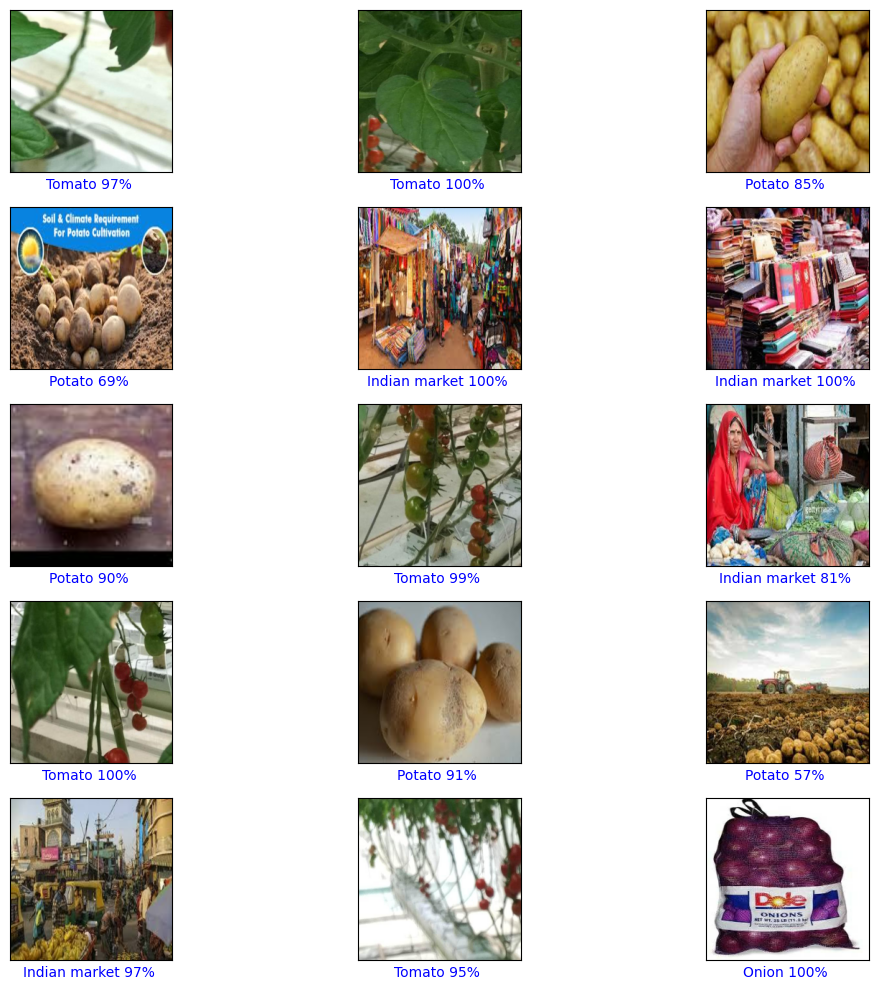

In [ ]:
true_categories = tf.concat([y for x, y in test_ds], axis=0)
images = tf.concat([x for x, y in test_ds], axis=0)
y_pred = model.predict(test_ds)
class_names = test_data.class_names

# Randomly sample 15 test images and plot it with their predicted labels, and the true labels.
indices = random.sample(range(len(images)), 15)
# Color correct predictions in blue and incorrect predictions in red.
num_rows = 5
num_cols = 3
num_images = num_rows*num_cols
plt.figure(figsize=(4*num_cols, 2*num_rows))
for i,index in enumerate(indices):
  plt.subplot(num_rows, num_cols, i+1)
  plot_image(y_pred[index], true_categories[index], images[index])

plt.tight_layout()
plt.show()

## VGG16 without Pretrained



#### Model Building & Training

In [ ]:
def vgg16_without_pretrained(height=224, width=224):
    num_classes = 4
    hidden_size = 256

    model = keras.Sequential(
        name="vgg16_without_pretrained",
        layers=[
            tf.keras.layers.Input(shape = (224 ,224, 3)),
            tf.keras.layers.Conv2D(64, kernel_size=(3,3), padding= 'same',
                            activation= 'relu'),
            tf.keras.layers.Conv2D(64, kernel_size=(3,3), padding= 'same',
                            activation= 'relu'),
            tf.keras.layers.MaxPooling2D(pool_size=(2,2), strides= (2,2)),

            tf.keras.layers.Conv2D(128, kernel_size=(3,3), padding= 'same',
                            activation= 'relu'),
            tf.keras.layers.Conv2D(128, kernel_size=(3,3), padding= 'same',
                            activation= 'relu'),
            tf.keras.layers.MaxPooling2D(pool_size=(2,2), strides= (2,2)),

            tf.keras.layers.Conv2D(256, kernel_size=(3,3), padding= 'same',
                            activation= 'relu'),
            tf.keras.layers.Conv2D(256, kernel_size=(3,3), padding= 'same',
                            activation= 'relu'),
            tf.keras.layers.Conv2D(256, kernel_size=(3,3), padding= 'same',
                            activation= 'relu'),
            tf.keras.layers.Conv2D(256, kernel_size=(3,3), padding= 'same',
                            activation= 'relu'),
            tf.keras.layers.MaxPooling2D(pool_size=(2,2), strides= (2,2)),

            tf.keras.layers.Conv2D(512, kernel_size=(3,3), padding= 'same',
                            activation= 'relu'),
            tf.keras.layers.Conv2D(512, kernel_size=(3,3), padding= 'same',
                            activation= 'relu'),
            tf.keras.layers.Conv2D(512, kernel_size=(3,3), padding= 'same',
                            activation= 'relu'),
            tf.keras.layers.Conv2D(512, kernel_size=(3,3),padding= 'same',
                            activation= 'relu'),
            tf.keras.layers.MaxPooling2D(pool_size=(2,2), strides= (2,2)),

            tf.keras.layers.Conv2D(512, kernel_size=(3,3),padding= 'same',
                            activation= 'relu'),
            tf.keras.layers.Conv2D(512, kernel_size=(3,3),padding= 'same',
                            activation= 'relu'),
            tf.keras.layers.Conv2D(512, kernel_size=(3,3),padding= 'same',
                            activation= 'relu'),
            tf.keras.layers.Conv2D(512, kernel_size=(3,3), padding= 'same',
                            activation= 'relu'),
            tf.keras.layers.MaxPooling2D(pool_size=(2,2), strides= (2,2)),

            tf.keras.layers.GlobalAveragePooling2D(),
            tf.keras.layers.Dense(4096, activation= 'relu'),
            tf.keras.layers.Dropout(0.5),
            #tf.keras.layers.Dense(4096, activation= 'relu'),
            #tf.keras.layers.Dropout(0.5),
            tf.keras.layers.Dense(4, activation= 'softmax')
        ]
    )
    return model

In [ ]:
model = vgg16_without_pretrained()
model.summary()

Model: "vgg16_without_pretrained"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_16 (Conv2D)          (None, 224, 224, 64)      1792      
                                                                 
 conv2d_17 (Conv2D)          (None, 224, 224, 64)      36928     
                                                                 
 max_pooling2d_13 (MaxPoolin  (None, 112, 112, 64)     0         
 g2D)                                                            
                                                                 
 conv2d_18 (Conv2D)          (None, 112, 112, 128)     73856     
                                                                 
 conv2d_19 (Conv2D)          (None, 112, 112, 128)     147584    
                                                                 
 max_pooling2d_14 (MaxPoolin  (None, 56, 56, 128)      0         
 g2D)                                     

In [ ]:
#!pip install tensorboard

In [ ]:
# tensorboard setup for visualization
log_dir = "pistol_Log"
!rm -rf log_dir

#### Data Preprocessing: Resizing, Standardization

In [ ]:
def preprocess(train_data, val_data, test_data, target_height=224, target_width=224):

    # Data Processing Stage with resizing and rescaling operations
    data_preprocess = tf.keras.Sequential(
        name="data_preprocess",
        layers=[
            tf.keras.layers.Resizing(target_height, target_width),
            tf.keras.layers.Rescaling(1.0/255),
        ]
    )

    # Perform Data Processing on the train, test dataset
    train_ds = train_data.map(lambda x, y: (data_preprocess(x), y), num_parallel_calls=tf.data.AUTOTUNE)
    val_ds = val_data.map(lambda x, y: (data_preprocess(x), y), num_parallel_calls=tf.data.AUTOTUNE)
    test_ds = test_data.map(lambda x, y: (data_preprocess(x), y), num_parallel_calls=tf.data.AUTOTUNE)

    return train_ds, val_ds, test_ds

In [ ]:
#!pip install split-folders

In [ ]:
#import splitfolders

In [ ]:
#input_folder = "ninjacart_data/train/"
#splitfolders.ratio(input_folder, output="output", seed=1337, ratio=(.8, .2), group_prefix=None, move=False)

In [ ]:
train_data = tf.keras.utils.image_dataset_from_directory("output/train/",shuffle=True, seed=123,image_size=(227, 227),batch_size=32)
val_data = tf.keras.utils.image_dataset_from_directory("output/val/",shuffle=False, seed=123,image_size=(227, 227),batch_size=32)
test_data = tf.keras.utils.image_dataset_from_directory("ninjacart_data/test/",shuffle=False, seed=123,image_size=(227, 227),batch_size=32)

train_ds, val_ds, test_ds = preprocess(train_data, val_data, test_data)

Found 2507 files belonging to 4 classes.
Found 628 files belonging to 4 classes.
Found 351 files belonging to 4 classes.


In [ ]:
def compile_train_v1(model, train_ds, val_ds, epochs=10, ckpt_path="/tmp/checkpoint"):
    model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=["accuracy"])
    tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir)
    checkpoint_cb = tf.keras.callbacks.ModelCheckpoint(ckpt_path, save_weights_only=True, monitor='val_loss', mode='min', save_best_only=True)
    early_stopping_cb = tf.keras.callbacks.EarlyStopping(patience=10, restore_best_weights=True)
    model_fit = model.fit(train_ds, validation_data=val_ds, epochs=epochs, class_weight = class_weight, callbacks=[checkpoint_cb, early_stopping_cb, tensorboard_callback])
    return model_fit

In [ ]:
model_fit = compile_train_v1(model, train_ds, val_ds, epochs=5)

Epoch 1/5
79/79 [==============================] - 63s 688ms/step - loss: 12.7015 - accuracy: 0.2449 - val_loss: 1.3888 - val_accuracy: 0.1911
Epoch 2/5
79/79 [==============================] - 45s 566ms/step - loss: 2.7744 - accuracy: 0.2369 - val_loss: 1.3879 - val_accuracy: 0.1911
Epoch 3/5
79/79 [==============================] - 43s 538ms/step - loss: 2.7738 - accuracy: 0.2234 - val_loss: 1.3874 - val_accuracy: 0.1911
Epoch 4/5
79/79 [==============================] - 45s 556ms/step - loss: 2.7740 - accuracy: 0.2242 - val_loss: 1.3876 - val_accuracy: 0.1911
Epoch 5/5
79/79 [==============================] - 45s 562ms/step - loss: 2.7737 - accuracy: 0.2517 - val_loss: 1.3864 - val_accuracy: 0.2707


In [ ]:
# Implement a TensorBoard callback to log each of our model metrics for each model during the training process.
%load_ext tensorboard
%tensorboard --logdir={log_dir}

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 413), started 0:32:58 ago. (Use '!kill 413' to kill it.)

<IPython.core.display.Javascript object>

#### Plotting Accuracy, Loss v/s Epochs for Train and Validation Data

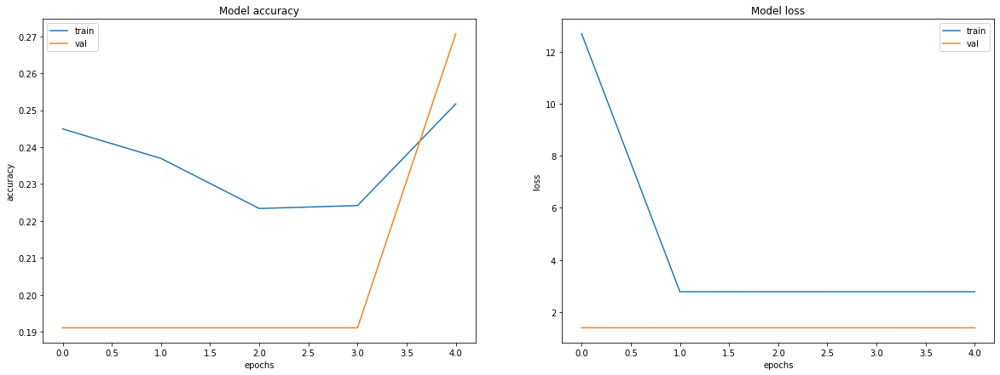

In [ ]:
fig, ax = plt.subplots(1, 2, figsize=(20, 7))
ax = ax.ravel()

for i, met in enumerate(["accuracy", "loss"]):
    ax[i].plot(model_fit.history[met])
    ax[i].plot(model_fit.history["val_" + met])
    ax[i].set_title("Model {}".format(met))
    ax[i].set_xlabel("epochs")
    ax[i].set_ylabel(met)
    ax[i].legend(["train", "val"])

#### Confusion Matrix, Precision & Recall

11/11 [==============================] - 5s 465ms/step
              precision    recall  f1-score   support

           0       0.00      0.00      0.00        81
           1       0.24      1.00      0.38        83
           2       0.00      0.00      0.00        81
           3       0.00      0.00      0.00       106

    accuracy                           0.24       351
   macro avg       0.06      0.25      0.10       351
weighted avg       0.06      0.24      0.09       351



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


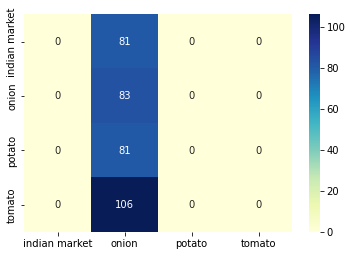

In [ ]:
def ConfusionMatrix(model, ds, label_list):
# Note: This logic doesn't work with shuffled datasets
    # run model prediction and obtain probabilities
    y_pred = model.predict(ds)
    # get list of predicted classes by taking argmax of the probabilities(y_pred)
    predicted_categories = tf.argmax(y_pred, axis=1)
    # create list of all "y"s labels, by iterating over test dataset
    true_categories = tf.concat([y for x, y in ds], axis=0)

    print(classification_report(true_categories, predicted_categories))

    # generate confusion matrix and plot it
    cm = metrics.confusion_matrix(true_categories,predicted_categories) # last batch
    sns.heatmap(cm, annot=True, xticklabels=label_list, yticklabels=label_list, cmap="YlGnBu", fmt='g')
    plt.show()

ConfusionMatrix(model, test_ds, test_data.class_names)

#### Evaluate Accuracy & Loss of the above model for Test Data

In [ ]:
# Evaluate the model
loss, acc = model.evaluate(test_ds, verbose=2)
print("Accuracy of the Model with Test Data: {:5.2f}%".format(100 * acc))
print("Loss of the Model with Test Data: {:5.4f}".format(loss))

11/11 - 2s - loss: 1.3863 - accuracy: 0.2365 - 2s/epoch - 185ms/step
Accuracy of the Model with Test Data: 23.65%
Loss of the Model with Test Data: 1.3863


#### Visualizing Final Predictions of the above Model for few random data in test dataset

In [ ]:
def plot_image(pred_array, true_label, img):
  plt.grid(False)
  plt.xticks([])
  plt.yticks([])

  plt.imshow(img, cmap=plt.cm.binary)

  predicted_label = np.argmax(pred_array)
  if predicted_label == true_label:
    color = 'blue'
  else:
    color = 'red'

  plt.xlabel("{} {:2.0f}% ".format(class_names[predicted_label],
                                100*np.max(pred_array),
                                ),
                                color=color)

11/11 [==============================] - 2s 181ms/step


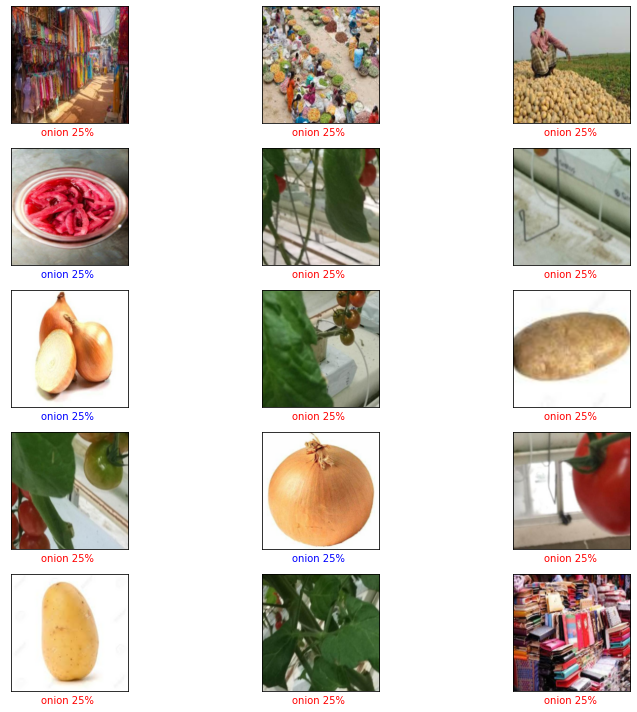

In [ ]:
true_categories = tf.concat([y for x, y in test_ds], axis=0)
images = tf.concat([x for x, y in test_ds], axis=0)
y_pred = model.predict(test_ds)
class_names = test_data.class_names

# Randomly sample 15 test images and plot it with their predicted labels, and the true labels.
indices = random.sample(range(len(images)), 15)
# Color correct predictions in blue and incorrect predictions in red.
num_rows = 5
num_cols = 3
num_images = num_rows*num_cols
plt.figure(figsize=(4*num_cols, 2*num_rows))
for i,index in enumerate(indices):
  plt.subplot(num_rows, num_cols, i+1)
  plot_image(y_pred[index], true_categories[index], images[index])

plt.tight_layout()
plt.show()

Inference of the Baseline Model:<br>
1> This model has poorly learnt. It has just learnt all the images as potatoes.<br>
2> Since it is getting trained from the begining, this might have not learnt thoroughly.


## VGG16 with Pretrained



#### Model Building & Training

In [ ]:
def vgg16_with_pretrained(height=128, width=128):
    num_classes = 4
    hidden_size = 256

    pretrained_model = tf.keras.applications.VGG16(weights='imagenet', include_top=False, input_shape=[height,width, 3])
    pretrained_model.trainable=False
    vgg16_model = tf.keras.Sequential([
        pretrained_model,
        tf.keras.layers.GlobalAveragePooling2D(),
        tf.keras.layers.Dense(256, activation= 'relu'),
        tf.keras.layers.Dropout(0.25),
        tf.keras.layers.Dense(64, activation= 'relu'),
        tf.keras.layers.Dense(num_classes, activation='softmax')
    ])
    return vgg16_model

In [ ]:
model = vgg16_with_pretrained()
model.summary()

58889256/58889256 [==============================] - 0s 0us/step
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 vgg16 (Functional)          (None, 4, 4, 512)         14714688  
                                                                 
 global_average_pooling2d_4   (None, 512)              0         
 (GlobalAveragePooling2D)                                        
                                                                 
 dense_10 (Dense)            (None, 256)               131328    
                                                                 
 dropout_4 (Dropout)         (None, 256)               0         
                                                                 
 dense_11 (Dense)            (None, 64)                16448     
                                                                 
 dense_12 (Dense)            (None, 4)                 26

In [ ]:
#!pip install tensorboard

In [ ]:
# tensorboard setup for visualization
log_dir = "pistol_Log"
!rm -rf log_dir

#### Data Preprocessing: Resizing, Standardization

In [ ]:
def preprocess(train_data, val_data, test_data, target_height=128, target_width=128):

    # Data Processing Stage with resizing and rescaling operations
    data_preprocess = tf.keras.Sequential(
        name="data_preprocess",
        layers=[
            tf.keras.layers.Resizing(target_height, target_width),
            tf.keras.layers.Rescaling(1.0/255),
        ]
    )

    # Perform Data Processing on the train, test dataset
    train_ds = train_data.map(lambda x, y: (data_preprocess(x), y), num_parallel_calls=tf.data.AUTOTUNE)
    val_ds = val_data.map(lambda x, y: (data_preprocess(x), y), num_parallel_calls=tf.data.AUTOTUNE)
    test_ds = test_data.map(lambda x, y: (data_preprocess(x), y), num_parallel_calls=tf.data.AUTOTUNE)

    return train_ds, val_ds, test_ds

In [ ]:
#!pip install split-folders

In [ ]:
#import splitfolders

In [ ]:
#input_folder = "ninjacart_data/train/"
#splitfolders.ratio(input_folder, output="output", seed=1337, ratio=(.8, .2), group_prefix=None, move=False)

In [ ]:
train_data = tf.keras.utils.image_dataset_from_directory("output/train/",shuffle=True, seed=123,image_size=(227, 227),batch_size=32)
val_data = tf.keras.utils.image_dataset_from_directory("output/val/",shuffle=False, seed=123,image_size=(227, 227),batch_size=32)
test_data = tf.keras.utils.image_dataset_from_directory("ninjacart_data/test/",shuffle=False, seed=123,image_size=(227, 227),batch_size=32)

train_ds, val_ds, test_ds = preprocess(train_data, val_data, test_data)

Found 2507 files belonging to 4 classes.
Found 628 files belonging to 4 classes.
Found 351 files belonging to 4 classes.


In [ ]:
def compile_train_v1(model, train_ds, val_ds, epochs=10, ckpt_path="/tmp/checkpoint"):
    model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=["accuracy"])
    tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir)
    checkpoint_cb = tf.keras.callbacks.ModelCheckpoint(ckpt_path, save_weights_only=True, monitor='val_loss', mode='min', save_best_only=True)
    early_stopping_cb = tf.keras.callbacks.EarlyStopping(patience=10, restore_best_weights=True)
    model_fit = model.fit(train_ds, validation_data=val_ds, epochs=epochs, class_weight = class_weight, callbacks=[checkpoint_cb, early_stopping_cb, tensorboard_callback])
    return model_fit

In [ ]:
model_fit = compile_train_v1(model, train_ds, val_ds, epochs=15)

Epoch 1/15
79/79 [==============================] - 14s 141ms/step - loss: 1.3213 - accuracy: 0.7144 - val_loss: 0.4223 - val_accuracy: 0.8137
Epoch 2/15
79/79 [==============================] - 10s 125ms/step - loss: 0.7451 - accuracy: 0.8476 - val_loss: 0.4252 - val_accuracy: 0.8185
Epoch 3/15
79/79 [==============================] - 10s 116ms/step - loss: 0.6039 - accuracy: 0.8720 - val_loss: 0.3152 - val_accuracy: 0.8742
Epoch 4/15
79/79 [==============================] - 10s 125ms/step - loss: 0.5040 - accuracy: 0.8923 - val_loss: 0.3488 - val_accuracy: 0.8615
Epoch 5/15
79/79 [==============================] - 10s 124ms/step - loss: 0.4723 - accuracy: 0.9059 - val_loss: 0.3239 - val_accuracy: 0.8822
Epoch 6/15
79/79 [==============================] - 11s 128ms/step - loss: 0.4272 - accuracy: 0.9186 - val_loss: 0.2933 - val_accuracy: 0.8917
Epoch 7/15
79/79 [==============================] - 11s 125ms/step - loss: 0.4048 - accuracy: 0.9158 - val_loss: 0.3045 - val_accuracy: 0.8790

In [ ]:
# Implement a TensorBoard callback to log each of our model metrics for each model during the training process.
%load_ext tensorboard
%tensorboard --logdir={log_dir}

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 413), started 0:36:53 ago. (Use '!kill 413' to kill it.)

<IPython.core.display.Javascript object>

#### Plotting Accuracy, Loss v/s Epochs for Train and Validation Data

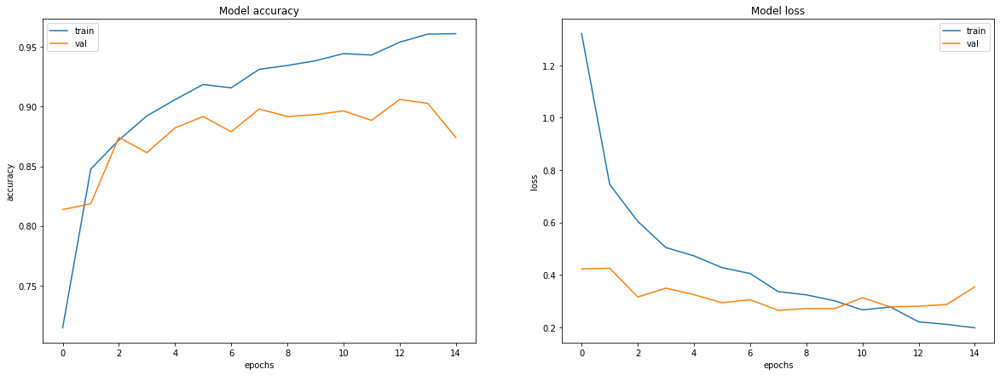

In [ ]:
fig, ax = plt.subplots(1, 2, figsize=(20, 7))
ax = ax.ravel()

for i, met in enumerate(["accuracy", "loss"]):
    ax[i].plot(model_fit.history[met])
    ax[i].plot(model_fit.history["val_" + met])
    ax[i].set_title("Model {}".format(met))
    ax[i].set_xlabel("epochs")
    ax[i].set_ylabel(met)
    ax[i].legend(["train", "val"])

#### Confusion Matrix, Precision & Recall

11/11 [==============================] - 3s 252ms/step
              precision    recall  f1-score   support

           0       0.95      0.89      0.92        81
           1       0.67      0.89      0.76        83
           2       0.88      0.60      0.72        81
           3       0.98      1.00      0.99       106

    accuracy                           0.86       351
   macro avg       0.87      0.85      0.85       351
weighted avg       0.87      0.86      0.86       351



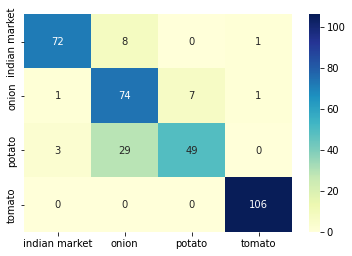

In [ ]:
def ConfusionMatrix(model, ds, label_list):
# Note: This logic doesn't work with shuffled datasets
    # run model prediction and obtain probabilities
    y_pred = model.predict(ds)
    # get list of predicted classes by taking argmax of the probabilities(y_pred)
    predicted_categories = tf.argmax(y_pred, axis=1)
    # create list of all "y"s labels, by iterating over test dataset
    true_categories = tf.concat([y for x, y in ds], axis=0)

    print(classification_report(true_categories, predicted_categories))

    # generate confusion matrix and plot it
    cm = metrics.confusion_matrix(true_categories,predicted_categories) # last batch
    sns.heatmap(cm, annot=True, xticklabels=label_list, yticklabels=label_list, cmap="YlGnBu", fmt='g')
    plt.show()

ConfusionMatrix(model, test_ds, test_data.class_names)

#### Evaluate Accuracy & Loss of the above model for Test Data

In [ ]:
# Evaluate the model
loss, acc = model.evaluate(test_ds, verbose=2)
print("Accuracy of the Model with Test Data: {:5.2f}%".format(100 * acc))
print("Loss of the Model with Test Data: {:5.4f}".format(loss))

11/11 - 1s - loss: 0.4741 - accuracy: 0.8575 - 1s/epoch - 99ms/step
Accuracy of the Model with Test Data: 85.75%
Loss of the Model with Test Data: 0.4741


#### Visualizing Final Predictions of the above Model for few random data in test dataset

In [ ]:
def plot_image(pred_array, true_label, img):
  plt.grid(False)
  plt.xticks([])
  plt.yticks([])

  plt.imshow(img, cmap=plt.cm.binary)

  predicted_label = np.argmax(pred_array)
  if predicted_label == true_label:
    color = 'blue'
  else:
    color = 'red'

  plt.xlabel("{} {:2.0f}% ".format(class_names[predicted_label],
                                100*np.max(pred_array),
                                ),
                                color=color)

11/11 [==============================] - 1s 111ms/step


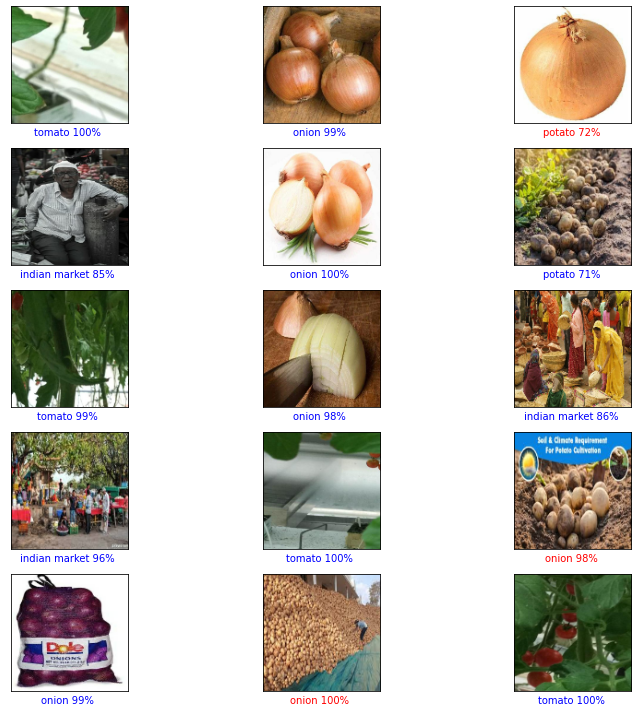

In [ ]:
true_categories = tf.concat([y for x, y in test_ds], axis=0)
images = tf.concat([x for x, y in test_ds], axis=0)
y_pred = model.predict(test_ds)
class_names = test_data.class_names

# Randomly sample 15 test images and plot it with their predicted labels, and the true labels.
indices = random.sample(range(len(images)), 15)
# Color correct predictions in blue and incorrect predictions in red.
num_rows = 5
num_cols = 3
num_images = num_rows*num_cols
plt.figure(figsize=(4*num_cols, 2*num_rows))
for i,index in enumerate(indices):
  plt.subplot(num_rows, num_cols, i+1)
  plot_image(y_pred[index], true_categories[index], images[index])

plt.tight_layout()
plt.show()

Inference of the above Model:<br>
1> As previous model, it was underfitting and has not learnt anything because I had done 3 main mistakes:

    (i) I used 224\*224 image size in the input which was ver big, instead using 128\*128 increased the accuracy. <br>
    (ii) I used Flatten() instead GlobalAveragePoling().<br>
    (iii) Increased the Fully Connected Layers.


## Resnet50



#### Model Building & Training

In [ ]:
def resnet50_pretrained(height=128, width=128):
    num_classes = 4
    hidden_size = 256

    pretrained_model = tf.keras.applications.ResNet50(weights='imagenet', include_top=False, input_shape=[height,width,3])
    pretrained_model.trainable=False
    resnet_model = tf.keras.Sequential([pretrained_model,
                                        tf.keras.layers.Flatten(),
                                        tf.keras.layers.Dense(128, activation= 'relu'),
                                        tf.keras.layers.Dropout(0.25),
                                        tf.keras.layers.Dense(32, activation= 'relu'),
                                        tf.keras.layers.Dense(num_classes, activation='softmax')])
    return resnet_model

In [ ]:
model = resnet50_pretrained()
model.summary()

94765736/94765736 [==============================] - 1s 0us/step
Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet50 (Functional)       (None, 4, 4, 2048)        23587712  
                                                                 
 flatten_1 (Flatten)         (None, 32768)             0         
                                                                 
 dense_13 (Dense)            (None, 128)               4194432   
                                                                 
 dropout_5 (Dropout)         (None, 128)               0         
                                                                 
 dense_14 (Dense)            (None, 32)                4128      
                                                                 
 dense_15 (Dense)            (None, 4)                 132       
                                                       

In [ ]:
#!pip install tensorboard

In [ ]:
# tensorboard setup for visualization
log_dir = "pistol_Log"
!rm -rf log_dir

#### Data Preprocessing: Resizing, Standardization

In [ ]:
def preprocess(train_data, val_data, test_data, target_height=128, target_width=128):

    # Data Processing Stage with resizing and rescaling operations
    data_preprocess = tf.keras.Sequential(
        name="data_preprocess",
        layers=[
            tf.keras.layers.Resizing(target_height, target_width),
            tf.keras.layers.Rescaling(1.0/255),
        ]
    )

    # Perform Data Processing on the train, test dataset
    train_ds = train_data.map(lambda x, y: (data_preprocess(x), y), num_parallel_calls=tf.data.AUTOTUNE)
    val_ds = val_data.map(lambda x, y: (data_preprocess(x), y), num_parallel_calls=tf.data.AUTOTUNE)
    test_ds = test_data.map(lambda x, y: (data_preprocess(x), y), num_parallel_calls=tf.data.AUTOTUNE)

    return train_ds, val_ds, test_ds

In [ ]:
#!pip install split-folders

In [ ]:
#import splitfolders

In [ ]:
#input_folder = "ninjacart_data/train/"
#splitfolders.ratio(input_folder, output="output", seed=1337, ratio=(.8, .2), group_prefix=None, move=False)

In [ ]:
train_data = tf.keras.utils.image_dataset_from_directory("output/train/",shuffle=True, seed=123,image_size=(227, 227),batch_size=32)
val_data = tf.keras.utils.image_dataset_from_directory("output/val/",shuffle=False, seed=123,image_size=(227, 227),batch_size=32)
test_data = tf.keras.utils.image_dataset_from_directory("ninjacart_data/test/",shuffle=False, seed=123,image_size=(227, 227),batch_size=32)

train_ds, val_ds, test_ds = preprocess(train_data, val_data, test_data)

Found 2507 files belonging to 4 classes.
Found 628 files belonging to 4 classes.
Found 351 files belonging to 4 classes.


In [ ]:
def compile_train_v1(model, train_ds, val_ds, epochs=10, ckpt_path="/tmp/checkpoint"):
    model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=["accuracy"])
    tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir)
    checkpoint_cb = tf.keras.callbacks.ModelCheckpoint(ckpt_path, save_weights_only=True, monitor='val_loss', mode='min', save_best_only=True)
    early_stopping_cb = tf.keras.callbacks.EarlyStopping(patience=10, restore_best_weights=True)
    model_fit = model.fit(train_ds, validation_data=val_ds, epochs=epochs, class_weight = class_weight, callbacks=[checkpoint_cb, early_stopping_cb, tensorboard_callback])
    return model_fit

In [ ]:
model_fit = compile_train_v1(model, train_ds, val_ds, epochs=25)

Epoch 1/25
79/79 [==============================] - 16s 147ms/step - loss: 2.8266 - accuracy: 0.3175 - val_loss: 1.3286 - val_accuracy: 0.3519
Epoch 2/25
79/79 [==============================] - 11s 134ms/step - loss: 2.4699 - accuracy: 0.4176 - val_loss: 1.1986 - val_accuracy: 0.4841
Epoch 3/25
79/79 [==============================] - 11s 133ms/step - loss: 2.2248 - accuracy: 0.4898 - val_loss: 1.1678 - val_accuracy: 0.4666
Epoch 4/25
79/79 [==============================] - 10s 124ms/step - loss: 2.1108 - accuracy: 0.5090 - val_loss: 1.0070 - val_accuracy: 0.5812
Epoch 5/25
79/79 [==============================] - 10s 122ms/step - loss: 2.0328 - accuracy: 0.5281 - val_loss: 0.9818 - val_accuracy: 0.5589
Epoch 6/25
79/79 [==============================] - 10s 117ms/step - loss: 1.9175 - accuracy: 0.5672 - val_loss: 1.0030 - val_accuracy: 0.5605
Epoch 7/25
79/79 [==============================] - 11s 135ms/step - loss: 1.8354 - accuracy: 0.5852 - val_loss: 0.9273 - val_accuracy: 0.6131

In [ ]:
# Implement a TensorBoard callback to log each of our model metrics for each model during the training process.
%load_ext tensorboard
%tensorboard --logdir={log_dir}

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 413), started 0:42:42 ago. (Use '!kill 413' to kill it.)

<IPython.core.display.Javascript object>

#### Plotting Accuracy, Loss v/s Epochs for Train and Validation Data

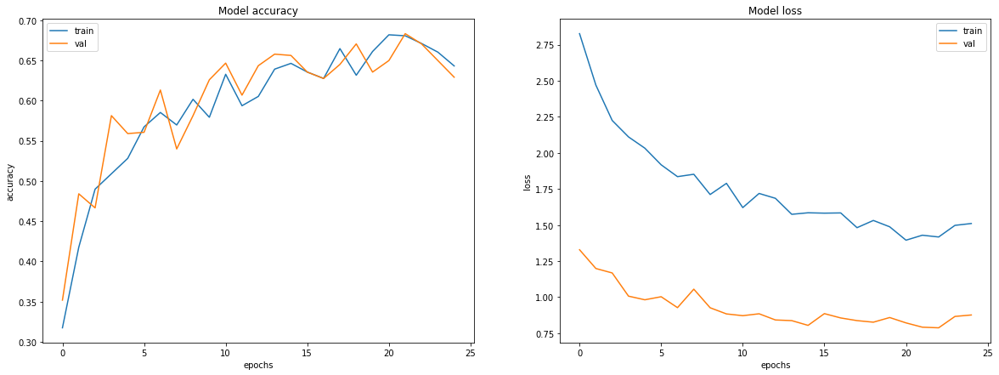

In [ ]:
fig, ax = plt.subplots(1, 2, figsize=(20, 7))
ax = ax.ravel()

for i, met in enumerate(["accuracy", "loss"]):
    ax[i].plot(model_fit.history[met])
    ax[i].plot(model_fit.history["val_" + met])
    ax[i].set_title("Model {}".format(met))
    ax[i].set_xlabel("epochs")
    ax[i].set_ylabel(met)
    ax[i].legend(["train", "val"])

#### Confusion Matrix, Precision & Recall

11/11 [==============================] - 3s 156ms/step
              precision    recall  f1-score   support

           0       0.65      0.68      0.66        81
           1       0.46      0.14      0.22        83
           2       0.41      0.62      0.50        81
           3       0.73      0.82      0.77       106

    accuracy                           0.58       351
   macro avg       0.56      0.57      0.54       351
weighted avg       0.57      0.58      0.55       351



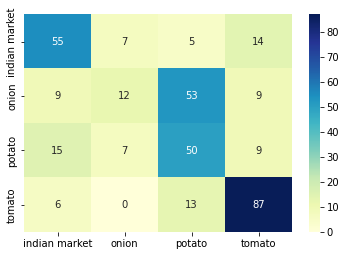

In [ ]:
def ConfusionMatrix(model, ds, label_list):
# Note: This logic doesn't work with shuffled datasets
    # run model prediction and obtain probabilities
    y_pred = model.predict(ds)
    # get list of predicted classes by taking argmax of the probabilities(y_pred)
    predicted_categories = tf.argmax(y_pred, axis=1)
    # create list of all "y"s labels, by iterating over test dataset
    true_categories = tf.concat([y for x, y in ds], axis=0)

    print(classification_report(true_categories, predicted_categories))

    # generate confusion matrix and plot it
    cm = metrics.confusion_matrix(true_categories,predicted_categories) # last batch
    sns.heatmap(cm, annot=True, xticklabels=label_list, yticklabels=label_list, cmap="YlGnBu", fmt='g')
    plt.show()

ConfusionMatrix(model, test_ds, test_data.class_names)

#### Evaluate Accuracy & Loss of the above model for Test Data

In [ ]:
# Evaluate the model
loss, acc = model.evaluate(test_ds, verbose=2)
print("Accuracy of the Model with Test Data: {:5.2f}%".format(100 * acc))
print("Loss of the Model with Test Data: {:5.4f}".format(loss))

11/11 - 1s - loss: 0.9716 - accuracy: 0.5812 - 1s/epoch - 100ms/step
Accuracy of the Model with Test Data: 58.12%
Loss of the Model with Test Data: 0.9716


#### Visualizing Final Predictions of the above Model for few random data in test dataset

In [ ]:
def plot_image(pred_array, true_label, img):
  plt.grid(False)
  plt.xticks([])
  plt.yticks([])

  plt.imshow(img, cmap=plt.cm.binary)

  predicted_label = np.argmax(pred_array)
  if predicted_label == true_label:
    color = 'blue'
  else:
    color = 'red'

  plt.xlabel("{} {:2.0f}% ".format(class_names[predicted_label],
                                100*np.max(pred_array),
                                ),
                                color=color)

11/11 [==============================] - 1s 109ms/step


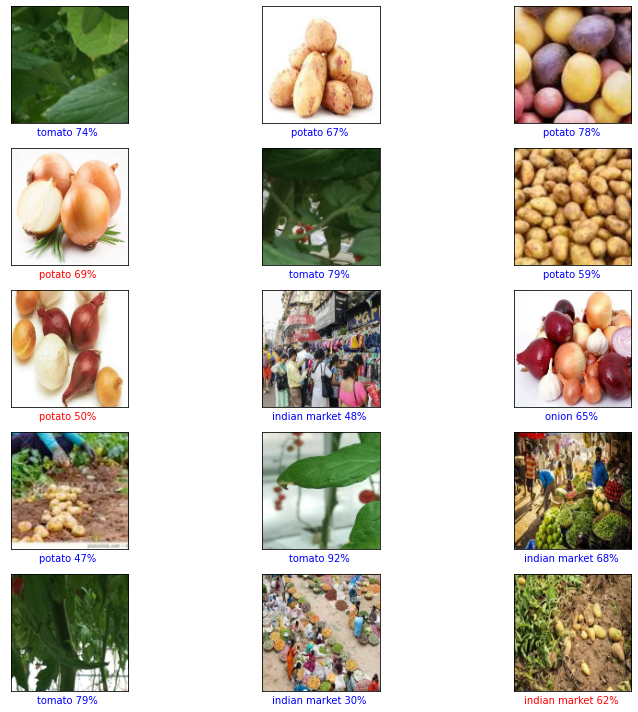

In [ ]:
true_categories = tf.concat([y for x, y in test_ds], axis=0)
images = tf.concat([x for x, y in test_ds], axis=0)
y_pred = model.predict(test_ds)
class_names = test_data.class_names

# Randomly sample 15 test images and plot it with their predicted labels, and the true labels.
indices = random.sample(range(len(images)), 15)
# Color correct predictions in blue and incorrect predictions in red.
num_rows = 5
num_cols = 3
num_images = num_rows*num_cols
plt.figure(figsize=(4*num_cols, 2*num_rows))
for i,index in enumerate(indices):
  plt.subplot(num_rows, num_cols, i+1)
  plot_image(y_pred[index], true_categories[index], images[index])

plt.tight_layout()
plt.show()

Inference of the above Model:<br>
1> Tried many things to improve the model - epochs, flatten/GAP, FCs; Resnet did not learn more. We just got Test Accuracy = 60%.


## Mobilenet



#### Model Building & Training

In [ ]:
def mobilenet_pretrained(height=128, width=128):
    num_classes = 4
    hidden_size = 256

    pretrained_model = tf.keras.applications.MobileNetV2(weights='imagenet', include_top=False, input_shape=[height,width,3])
    pretrained_model.trainable=False
    mobilenet_model = tf.keras.Sequential([pretrained_model,
                                        tf.keras.layers.GlobalAveragePooling2D(),
                                        tf.keras.layers.Dense(128, activation= 'relu'),
                                        tf.keras.layers.Dense(64, activation= 'relu'),
                                        tf.keras.layers.Dense(num_classes, activation='softmax')])
    return mobilenet_model

In [ ]:
model = mobilenet_pretrained()
model.summary()

9406464/9406464 [==============================] - 0s 0us/step
Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 mobilenetv2_1.00_128 (Funct  (None, 4, 4, 1280)       2257984   
 ional)                                                          
                                                                 
 global_average_pooling2d_5   (None, 1280)             0         
 (GlobalAveragePooling2D)                                        
                                                                 
 dense_16 (Dense)            (None, 128)               163968    
                                                                 
 dense_17 (Dense)            (None, 64)                8256      
                                                                 
 dense_18 (Dense)            (None, 4)                 260       
                                                         

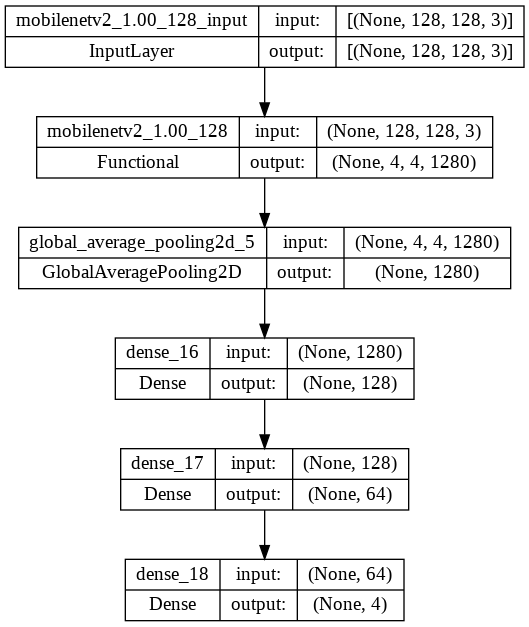

In [ ]:
#plot the model
tf.keras.utils.plot_model(model, to_file='model.png', show_shapes=True, show_dtype=False,show_layer_names=True, rankdir='TB', expand_nested=False, dpi=96)

In [ ]:
#!pip install tensorboard

In [ ]:
# tensorboard setup for visualization
log_dir = "pistol_Log"
!rm -rf log_dir

#### Data Preprocessing: Resizing, Standardization

In [ ]:
def preprocess(train_data, val_data, test_data, target_height=128, target_width=128):

    # Data Processing Stage with resizing and rescaling operations
    data_preprocess = tf.keras.Sequential(
        name="data_preprocess",
        layers=[
            tf.keras.layers.Resizing(target_height, target_width),
            tf.keras.layers.Rescaling(1.0/255),
        ]
    )

    # Perform Data Processing on the train, test dataset
    train_ds = train_data.map(lambda x, y: (data_preprocess(x), y), num_parallel_calls=tf.data.AUTOTUNE)
    val_ds = val_data.map(lambda x, y: (data_preprocess(x), y), num_parallel_calls=tf.data.AUTOTUNE)
    test_ds = test_data.map(lambda x, y: (data_preprocess(x), y), num_parallel_calls=tf.data.AUTOTUNE)

    return train_ds, val_ds, test_ds

In [ ]:
#!pip install split-folders

In [ ]:
#import splitfolders

In [ ]:
#input_folder = "ninjacart_data/train/"
#splitfolders.ratio(input_folder, output="output", seed=1337, ratio=(.8, .2), group_prefix=None, move=False)

In [ ]:
train_data = tf.keras.utils.image_dataset_from_directory("output/train/",shuffle=True, seed=123,image_size=(227, 227),batch_size=32)
val_data = tf.keras.utils.image_dataset_from_directory("output/val/",shuffle=False, seed=123,image_size=(227, 227),batch_size=32)
test_data = tf.keras.utils.image_dataset_from_directory("ninjacart_data/test/",shuffle=False, seed=123,image_size=(227, 227),batch_size=32)

train_ds, val_ds, test_ds = preprocess(train_data, val_data, test_data)

Found 2507 files belonging to 4 classes.
Found 628 files belonging to 4 classes.
Found 351 files belonging to 4 classes.


In [ ]:
def compile_train_v1(model, train_ds, val_ds, epochs=10, ckpt_path="/tmp/checkpoint"):
    model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=["accuracy"])
    tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir)
    checkpoint_cb = tf.keras.callbacks.ModelCheckpoint(ckpt_path, save_weights_only=True, monitor='val_loss', mode='min', save_best_only=True)
    early_stopping_cb = tf.keras.callbacks.EarlyStopping(patience=10, restore_best_weights=True)
    model_fit = model.fit(train_ds, validation_data=val_ds, epochs=epochs, class_weight = class_weight, callbacks=[checkpoint_cb, early_stopping_cb, tensorboard_callback])
    return model_fit

In [ ]:
model_fit = compile_train_v1(model, train_ds, val_ds, epochs=5)

Epoch 1/5
79/79 [==============================] - 13s 125ms/step - loss: 0.5659 - accuracy: 0.8931 - val_loss: 0.1311 - val_accuracy: 0.9363
Epoch 2/5
79/79 [==============================] - 9s 109ms/step - loss: 0.1270 - accuracy: 0.9777 - val_loss: 0.1389 - val_accuracy: 0.9459
Epoch 3/5
79/79 [==============================] - 10s 123ms/step - loss: 0.0542 - accuracy: 0.9928 - val_loss: 0.1202 - val_accuracy: 0.9538
Epoch 4/5
79/79 [==============================] - 10s 123ms/step - loss: 0.0257 - accuracy: 0.9956 - val_loss: 0.1182 - val_accuracy: 0.9602
Epoch 5/5
79/79 [==============================] - 9s 110ms/step - loss: 0.0111 - accuracy: 0.9996 - val_loss: 0.1370 - val_accuracy: 0.9522


In [ ]:
# Implement a TensorBoard callback to log each of our model metrics for each model during the training process.
%load_ext tensorboard
%tensorboard --logdir={log_dir}

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 413), started 0:44:07 ago. (Use '!kill 413' to kill it.)

<IPython.core.display.Javascript object>

#### Plotting Accuracy, Loss v/s Epochs for Train and Validation Data

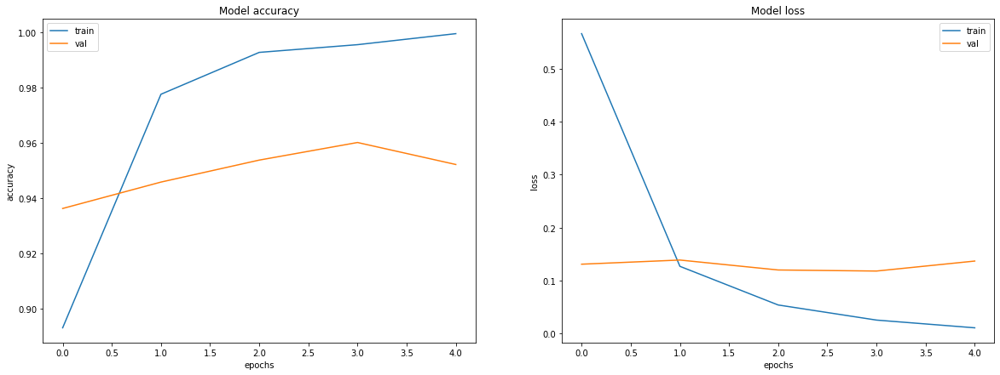

In [ ]:
fig, ax = plt.subplots(1, 2, figsize=(20, 7))
ax = ax.ravel()

for i, met in enumerate(["accuracy", "loss"]):
    ax[i].plot(model_fit.history[met])
    ax[i].plot(model_fit.history["val_" + met])
    ax[i].set_title("Model {}".format(met))
    ax[i].set_xlabel("epochs")
    ax[i].set_ylabel(met)
    ax[i].legend(["train", "val"])

#### Confusion Matrix, Precision & Recall

11/11 [==============================] - 2s 136ms/step
              precision    recall  f1-score   support

           0       0.97      0.86      0.92        81
           1       0.77      0.95      0.85        83
           2       0.94      0.81      0.87        81
           3       1.00      1.00      1.00       106

    accuracy                           0.91       351
   macro avg       0.92      0.91      0.91       351
weighted avg       0.93      0.91      0.92       351



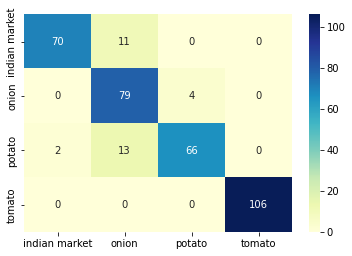

In [ ]:
def ConfusionMatrix(model, ds, label_list):
# Note: This logic doesn't work with shuffled datasets
    # run model prediction and obtain probabilities
    y_pred = model.predict(ds)
    # get list of predicted classes by taking argmax of the probabilities(y_pred)
    predicted_categories = tf.argmax(y_pred, axis=1)
    # create list of all "y"s labels, by iterating over test dataset
    true_categories = tf.concat([y for x, y in ds], axis=0)

    print(classification_report(true_categories, predicted_categories))

    # generate confusion matrix and plot it
    cm = metrics.confusion_matrix(true_categories,predicted_categories) # last batch
    sns.heatmap(cm, annot=True, xticklabels=label_list, yticklabels=label_list, cmap="YlGnBu", fmt='g')
    plt.show()

ConfusionMatrix(model, test_ds, test_data.class_names)

#### Evaluate Accuracy & Loss of the above model for Test Data

In [ ]:
# Evaluate the model
loss, acc = model.evaluate(test_ds, verbose=2)
print("Accuracy of the Model with Test Data: {:5.2f}%".format(100 * acc))
print("Loss of the Model with Test Data: {:5.4f}".format(loss))

11/11 - 1s - loss: 0.4516 - accuracy: 0.9145 - 1s/epoch - 97ms/step
Accuracy of the Model with Test Data: 91.45%
Loss of the Model with Test Data: 0.4516


#### Visualizing Final Predictions of the above Model for few random data in test dataset

In [ ]:
def plot_image(pred_array, true_label, img):
  plt.grid(False)
  plt.xticks([])
  plt.yticks([])

  plt.imshow(img, cmap=plt.cm.binary)

  predicted_label = np.argmax(pred_array)
  if predicted_label == true_label:
    color = 'blue'
  else:
    color = 'red'

  plt.xlabel("{} {:2.0f}% ".format(class_names[predicted_label],
                                100*np.max(pred_array),
                                ),
                                color=color)

11/11 [==============================] - 1s 104ms/step


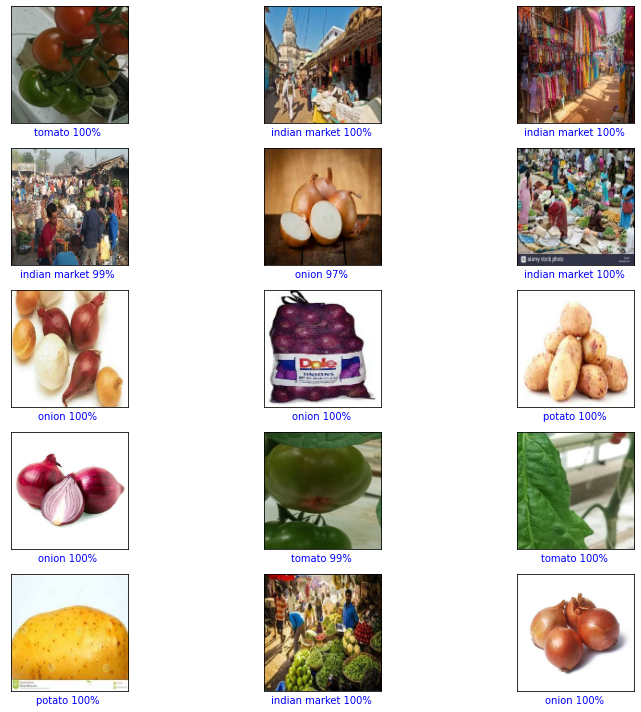

In [ ]:
true_categories = tf.concat([y for x, y in test_ds], axis=0)
images = tf.concat([x for x, y in test_ds], axis=0)
y_pred = model.predict(test_ds)
class_names = test_data.class_names

# Randomly sample 15 test images and plot it with their predicted labels, and the true labels.
indices = random.sample(range(len(images)), 15)
# Color correct predictions in blue and incorrect predictions in red.
num_rows = 5
num_cols = 3
num_images = num_rows*num_cols
plt.figure(figsize=(4*num_cols, 2*num_rows))
for i,index in enumerate(indices):
  plt.subplot(num_rows, num_cols, i+1)
  plot_image(y_pred[index], true_categories[index], images[index])

plt.tight_layout()
plt.show()

Inference of the above Model:<br>
1> This model has really learnt better than any other above models with Test Accuracy = 92%.
